# Pricipal Component Analysis from scratch on MNIST dataset


# Librairies


In [214]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sb
import plotly.offline as py



# Load MNIST Digits

In [122]:
from keras.datasets import mnist
(x_train, y_train), (x_test, y_test) = mnist.load_data()

X = x_train.reshape(len(x_train),-1)
y = y_train

# Partie 2 : PCA

In [206]:
def PCA(X ,num_components,variant):
     
    #Step-1
    X_meaned = X - np.mean(X , axis = 0)
     
    #Step-2
    cov_mat = np.cov(X_meaned , rowvar = False)
     
    #Step-3
    eigen_values , eigen_vectors = np.linalg.eigh(cov_mat)
     
    #Step-4
    sorted_index = np.argsort(eigen_values)[::-1]
    sorted_eigenvalue = eigen_values[sorted_index]
    sorted_eigenvectors = eigen_vectors[:,sorted_index]
     
    #Step-5
    eigenvector_subset = sorted_eigenvectors[:,variant:variant+num_components]
     
    #Step-6
    X_reduced = np.dot(eigenvector_subset.transpose() , X_meaned.transpose() ).transpose()
     
    return X_reduced

In [205]:
#n_components = 10
#mat_reduced = PCA(X ,n_components)

In [191]:
def class_target(y):
    d = {'Classe':list(y)}
    dfs = pd.DataFrame(d)
    target = dfs.iloc[:,0]
    return target

## n_components = 2    -    2D

In [201]:
def plotPCA_2D(principal_df,num):
    plt.figure(figsize = (10,10))
    sb.scatterplot(data = principal_df , x = 'PC1',y = 'PC2', hue = 'Classe' , s = 60 , palette= 'icefire')
    plt.title('Example N° : ' +num )

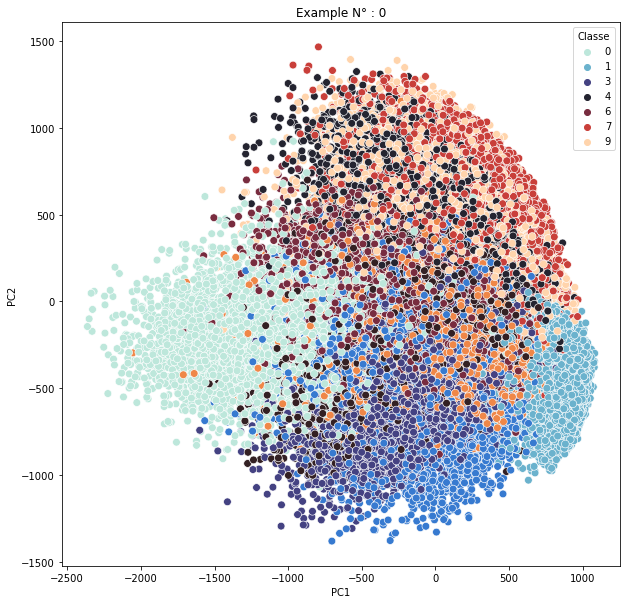

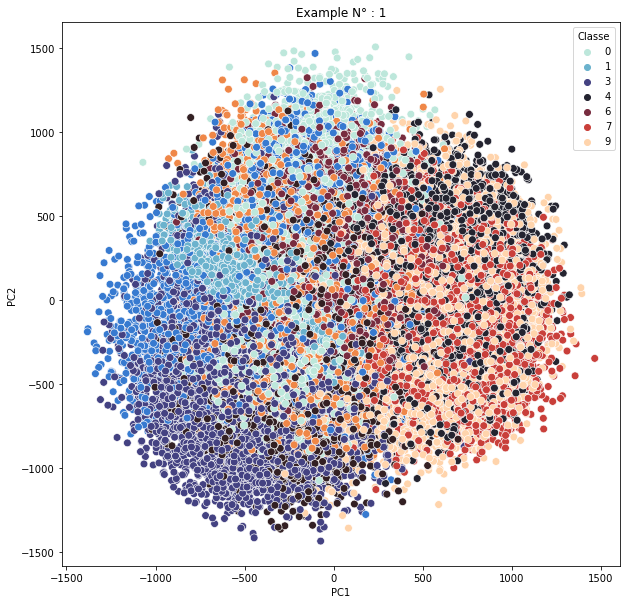

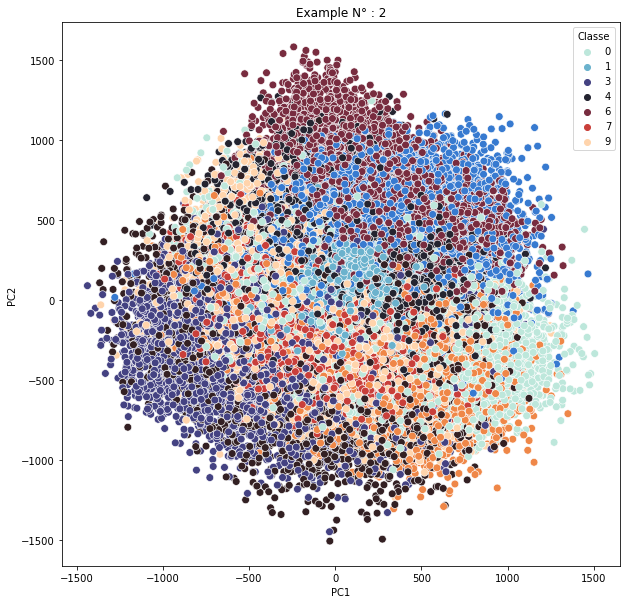

In [209]:
n_components=2
for i in range(0,3):
    variant = i
    mat_reduced = PCA(X ,n_components,variant)
    target=class_target(y_train)
    principal_df = pd.DataFrame(mat_reduced , columns = ['PC1','PC2'])
    principal_df = pd.concat([principal_df , pd.DataFrame(target)] , axis = 1)
    plotPCA_2D(principal_df,str(i))

## n_components = 3    -    3D

In [221]:
def plot_pca_3d(points, out):
    scatter = {
        'mode':"markers",
        'name': "y",
        'type': "scatter3d",    
        'x': points[:,0], 
        'y': points[:,1], 
        'z': points[:,2],
        'marker': {'size':2, 'color':out, 'colorscale':'Rainbow'}
    }
    fig = {'data':[scatter], 'layout': {'title':"***"}}
    py.iplot(fig)

In [222]:
n_components=3
for i in range(0,3):
    variant = i
    mat_reduced = PCA(X ,n_components,variant)
    target=class_target(y_train)
    Y_pca = target
    plot_pca_3d(X_pca, Y_pca)

# FIN